#**Downloads**

In [ ]:
# !pp install keras-adamw
# !pip install -U tensorflow-addons
# !pip install livelossplot
# !pip install tensorflow-addons[tensorflow]

#**Important Libs**

In [49]:
import pandas as pd
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
import tensorflow as tf
import numpy as np
import csv
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score,accuracy_score ,  balanced_accuracy_score,classification_report,plot_confusion_matrix , confusion_matrix
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import InputLayer
from tensorflow.keras.layers import Dense
import tensorflow as tf
import tensorflow_addons as tfa
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.manifold import TSNE
import matplotlib.colors as mcolors
from sklearn.utils.multiclass import unique_labels
from livelossplot import PlotLossesKeras
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, accuracy_score, confusion_matrix
from re import I
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_classif, chi2, f_classif

import numpy as np
from scipy import stats
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.callbacks import ModelCheckpoint
import plotly.express as px
from sklearn.decomposition import PCA
le=LabelEncoder()


#**Reading Data**

In [53]:
trainData = pd.read_csv ('train.csv')
testData = pd.read_csv ('test.csv')
valData = pd.read_csv ('val.csv')

In [3]:
trainData.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2619 entries, 0 to 2618
Data columns (total 22 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   Switch ID                      2619 non-null   object
 1   Port Number                    2619 non-null   object
 2   Received Packets               2619 non-null   int64 
 3   Received Bytes                 2619 non-null   int64 
 4   Sent Bytes                     2619 non-null   int64 
 5   Sent Packets                   2619 non-null   int64 
 6   Port alive Duration (S)        2619 non-null   int64 
 7   Delta Received Packets         2619 non-null   int64 
 8   Delta Received Bytes           2619 non-null   int64 
 9   Delta Sent Bytes               2619 non-null   int64 
 10  Delta Sent Packets             2619 non-null   int64 
 11  Delta Port alive Duration (S)  2619 non-null   int64 
 12  Connection Point               2619 non-null   int64 
 13  Tot

In [4]:
testData.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 561 entries, 0 to 560
Data columns (total 22 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   Switch ID                      561 non-null    object
 1   Port Number                    561 non-null    object
 2   Received Packets               561 non-null    int64 
 3   Received Bytes                 561 non-null    int64 
 4   Sent Bytes                     561 non-null    int64 
 5   Sent Packets                   561 non-null    int64 
 6   Port alive Duration (S)        561 non-null    int64 
 7   Delta Received Packets         561 non-null    int64 
 8   Delta Received Bytes           561 non-null    int64 
 9   Delta Sent Bytes               561 non-null    int64 
 10  Delta Sent Packets             561 non-null    int64 
 11  Delta Port alive Duration (S)  561 non-null    int64 
 12  Connection Point               561 non-null    int64 
 13  Total

In [5]:
valData.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 561 entries, 0 to 560
Data columns (total 22 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   Switch ID                      561 non-null    object
 1   Port Number                    561 non-null    object
 2   Received Packets               561 non-null    int64 
 3   Received Bytes                 561 non-null    int64 
 4   Sent Bytes                     561 non-null    int64 
 5   Sent Packets                   561 non-null    int64 
 6   Port alive Duration (S)        561 non-null    int64 
 7   Delta Received Packets         561 non-null    int64 
 8   Delta Received Bytes           561 non-null    int64 
 9   Delta Sent Bytes               561 non-null    int64 
 10  Delta Sent Packets             561 non-null    int64 
 11  Delta Port alive Duration (S)  561 non-null    int64 
 12  Connection Point               561 non-null    int64 
 13  Total

#**Functions**

In [61]:
def EDA(x):
  plt.figure(figsize=(15,7))
  class_distribution1 = x['Label'].value_counts()
  class_distribution1.plot(kind='bar')
  plt.xlabel('Class')
  plt.ylabel('Data points per Class')
  plt.title('Distribution of train data')
  plt.grid()
  plt.show()
  sorted_yi = np.argsort(-class_distribution1.values)
  for i in sorted_yi:
      print('Number of data points in class', class_distribution1.index[i],':', class_distribution1.values[i], 
            '(', np.round((class_distribution1.values[i]/x.shape[0]*100), 3), '%)')
def split(x):
  xtrain=x.drop(["Label"],axis=1)
  ytrain=x["Label"]
  return xtrain,ytrain
def plot(x,y):
  data=x                              
  data_labels=y                        
  tsne = TSNE(n_components=2, random_state=0)
  X_2d = tsne.fit_transform(data) 
  classes=unique_labels(data_labels)         
  target_ids = range(len(classes))
  plt.figure(figsize=(6, 5))
  colors = 'r', 'g', 'b', 'c', 'm', 'y', 'k', 'orange' , 'tomato' , 'lime'
  for i, c, label in zip(target_ids, colors, classes):
      plt.scatter(X_2d[data_labels == i,1], X_2d[data_labels == i, 0], c=c, label=label)
  plt.xlabel('TSNE COMP1')
  plt.ylabel('TSNE COMP2')
  plt.legend()
  plt.show()
def scale(x,x1,x2):
  scalar=StandardScaler()
  scalar.fit(x)
  x=scalar.transform(x)
  x1=scalar.transform(x1)
  x2=scalar.transform(x2)
  return x,x1,x2
def encoding(x):
  l=["Label"]
  for z, i  in enumerate(x['Switch ID']):
    x['Switch ID'][z] = x['Switch ID'][z][-1]
    x['Port Number'][z] = x['Port Number'][z][-1]
  encoder = OneHotEncoder()
  #perorm one-hot encoding on 'team' column 
  encoder_df = pd.DataFrame(encoder.fit_transform(x[['Switch ID']]).toarray())
  #merge one-hot encoded columns back with original DataFrame
  x = x.join(encoder_df)
  x.drop('Switch ID', axis=1, inplace=True)
  for i in l:
    x[i] = le.fit_transform(x[i])
  return x
def vote(pre):
  finalPred =[]
  for z ,i in  enumerate(pre[0]):
    checkMax =[]
    for jj , j in enumerate(pre):
      checkMax.append(j[z])
    max = 0
    res = checkMax[0]
    for i in checkMax:
      freq = checkMax.count(i)
      if freq > max:
          max = freq
          res = i
    finalPred.append(res)
  return finalPred
def feat(X_train,y_train):
  modelCheck = ExtraTreesClassifier()
  modelCheck.fit(X_train,y_train)
  print(modelCheck.feature_importances_) #use inbuilt class feature_importances of tree based classifiers
  #plot graph of feature importances for better visualization
  feat_importances = pd.Series(modelCheck.feature_importances_, index=trainData.columns.drop('Label'))
  feat_importances.nlargest(10).plot(kind='barh')
  plt.title('most important features',fontsize=10,loc='center',color='b')
  plt.xlabel('Data')
  plt.ylabel('Features')
def gethigh(d):
    print("Maximum accuracy:", max(d.values()))
    print("Best number of features:", max(d, key=d.get))
def sortResult(data,i):
    sorFrame  =pd.DataFrame(data) 
    sorFrame = sorFrame.sort_values(by=[i])
    return sorFrame
def callmodel(X_train, y_train, X_test, y_test,X_val,y_val, SM, model):
      scoresk=[]
      component=2
      nf=2
      acc_dict2={}
      score=None
      if SM==SelectKBest(mutual_info_classif, k=component):
            SM=SelectKBest(mutual_info_classif, k=component)
      elif SM==SelectKBest(f_classif, k=nf):
            SM= SelectKBest(f_classif, k=nf)
      else:
            SM=PCA(n_components=component,random_state=0)
      for component in range(2,X_train.shape[1]-1):
            filepath="./maboe017/weights-improvement-best.hdf5"
            checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
            callbacks_list = [checkpoint]
            SM = SM
            pca_trdata=SM.fit_transform(X_train)
            pca_tedata=SM.transform(X_test)
            pca_vadata=SM.transform(X_val)
            model = keras.Sequential()
            model.add(Dense(10, input_shape = (pca_trdata.shape[1],), activation = "relu"))
            model.add(Dense(6, activation = "softmax"))
            optimizer = tfa.optimizers.AdamW(learning_rate=0.001,weight_decay=0.004)
            model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
            model.fit(pca_trdata,y_train, validation_data=(pca_vadata,y_val), epochs=100, batch_size=1,callbacks= callbacks_list)
            model.load_weights(filepath)
            score=model.evaluate(pca_tedata,y_test, verbose=0)[1]
            scoresk.append(score)
            acc_dict2[component] = score
      return scoresk,acc_dict2
def find_outliers_IQR(data):
  fig=None
  l=["Label","Switch ID","Port Number"]
  for i in l:
    data[i]=le.fit_transform(data[i])
  Q1 = data.quantile(0.25)
  Q3 = data.quantile(0.75)
  IQR = Q3 - Q1
  outliers=((data < (Q1 - 1.5 * IQR)) | (data > (Q3 + 1.5 * IQR))).sum()
  col=data.columns
  for i in col:
    fig=px.box(data[i])
    fig.show()
  return outliers


#**EDA**

##Data Description

In [ ]:
print("Read {} rows in TrainData.".format(len(trainData)))
print('='*40)
print("Read {} rows in TestData.".format(len(testData)))
print('='*40)
print("Read {} rows in ValidData.".format(len(valData)))
print('='*40)
print('The number of features for all data are:', trainData.shape[1])
print('='*40)
output = trainData['Label'].values
labels = set(output)
print('The different type of output labels are:', labels)
print('='*125)
print('The number of different output labels are:', len(labels))

Read 2619 rows in TrainData.
Read 561 rows in TestData.
Read 561 rows in ValidData.
The number of features for all data are: 22
The different type of output labels are: {'PortScan', 'Overflow', 'Diversion', 'Normal', 'Blackhole', 'TCP-SYN'}
The number of different output labels are: 6


##**Nulls in data**

In [ ]:
print('Null values in dataset are',len(trainData[trainData.isnull().any(1)]))
print('='*40)
print('Null values in dataset are',len(testData[testData.isnull().any(1)]))
print('='*40)
print('Null values in dataset are',len(valData[valData.isnull().any(1)]))
print('='*40)

Null values in dataset are 0
Null values in dataset are 0
Null values in dataset are 0


##**Visulize Data**

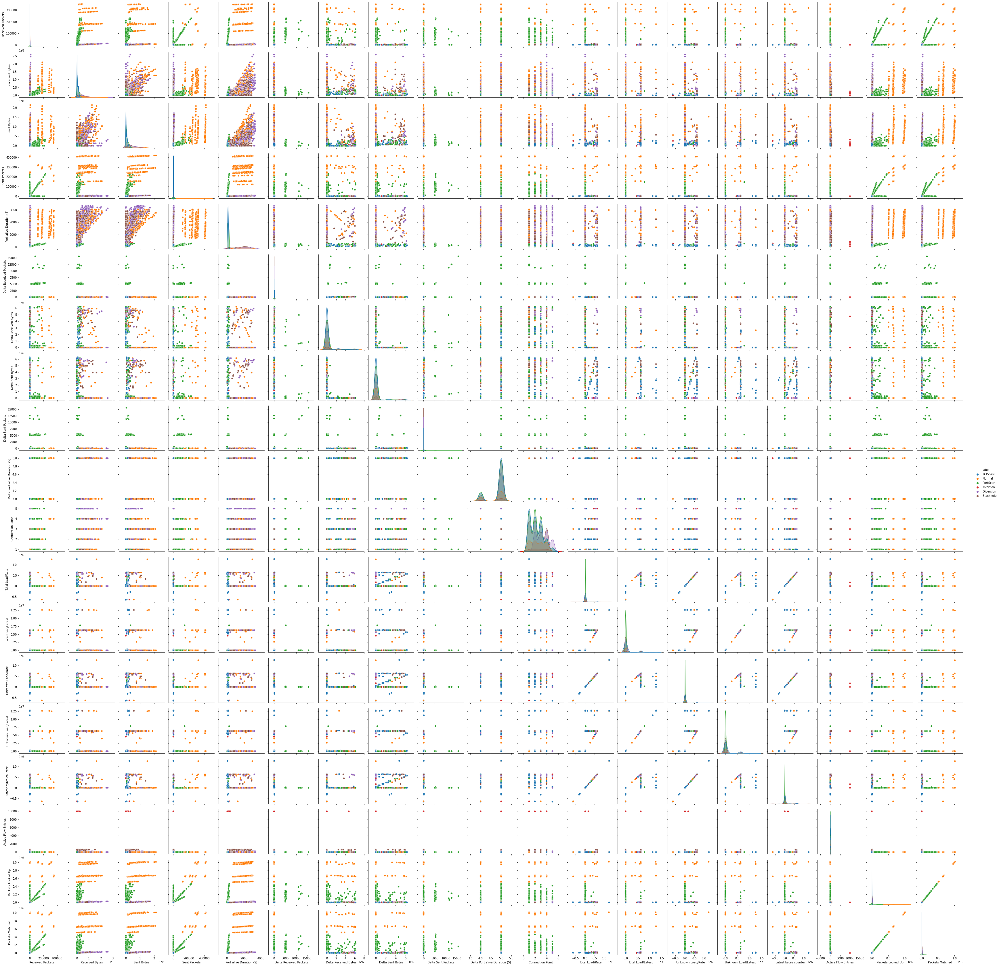

In [ ]:
sns_plot=sns.pairplot(trainData,hue='Label')

##**Number of instances per class**

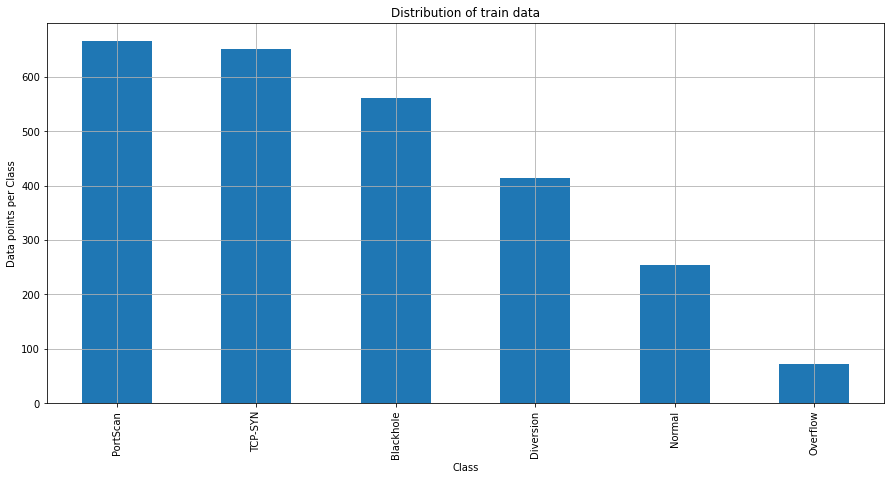

Number of data points in class PortScan : 666 ( 25.43 %)
Number of data points in class TCP-SYN : 651 ( 24.857 %)
Number of data points in class Blackhole : 561 ( 21.42 %)
Number of data points in class Diversion : 414 ( 15.808 %)
Number of data points in class Normal : 254 ( 9.698 %)
Number of data points in class Overflow : 73 ( 2.787 %)


In [ ]:
EDA(trainData)

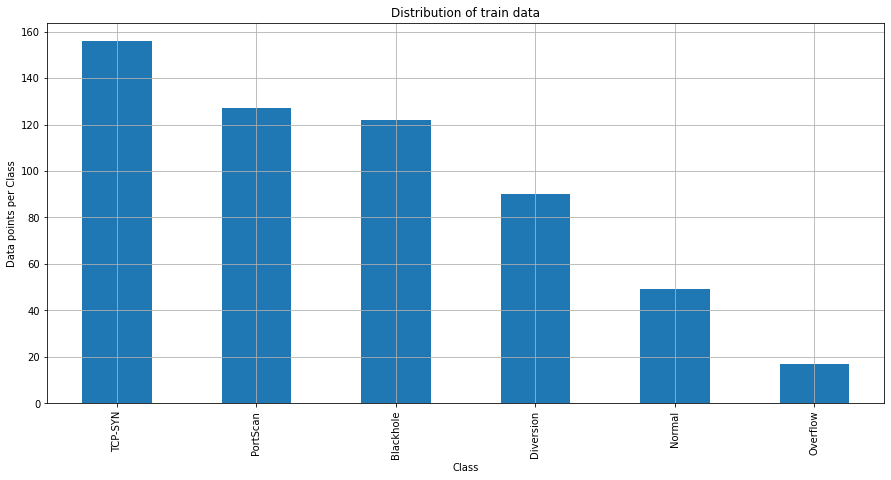

Number of data points in class TCP-SYN : 156 ( 27.807 %)
Number of data points in class PortScan : 127 ( 22.638 %)
Number of data points in class Blackhole : 122 ( 21.747 %)
Number of data points in class Diversion : 90 ( 16.043 %)
Number of data points in class Normal : 49 ( 8.734 %)
Number of data points in class Overflow : 17 ( 3.03 %)


In [ ]:
EDA(testData)

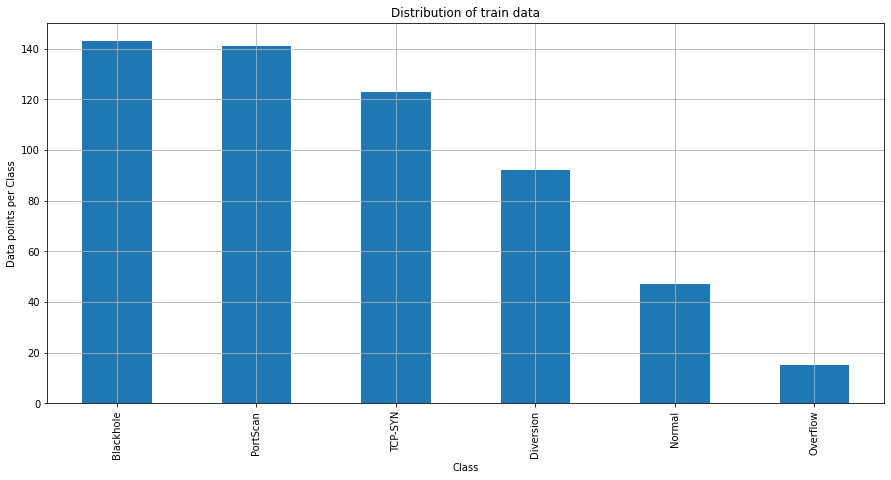

Number of data points in class Blackhole : 143 ( 25.49 %)
Number of data points in class PortScan : 141 ( 25.134 %)
Number of data points in class TCP-SYN : 123 ( 21.925 %)
Number of data points in class Diversion : 92 ( 16.399 %)
Number of data points in class Normal : 47 ( 8.378 %)
Number of data points in class Overflow : 15 ( 2.674 %)


In [ ]:
EDA(valData)

##**Outliers**

In [45]:
find_outliers_IQR(trainData)

Switch ID                          0
Port Number                        0
Received Packets                 312
Received Bytes                   186
Sent Bytes                       222
Sent Packets                     379
Port alive Duration (S)            0
Delta Received Packets           649
Delta Received Bytes             648
Delta Sent Bytes                 604
Delta Sent Packets               604
Delta Port alive Duration (S)    441
Connection Point                   0
Total Load/Rate                  396
Total Load/Latest                501
Unknown Load/Rate                396
Unknown Load/Latest              501
Latest bytes counter             396
Active Flow Entries              152
Packets Looked Up                536
Packets Matched                  536
Label                              0
dtype: int64

In [32]:
find_outliers_IQR(testData)

Switch ID                          0
Port Number                        0
Received Packets                  69
Received Bytes                    38
Sent Bytes                        54
Sent Packets                      78
Port alive Duration (S)            0
Delta Received Packets           130
Delta Received Bytes             124
Delta Sent Bytes                 127
Delta Sent Packets               127
Delta Port alive Duration (S)     89
Connection Point                   0
Total Load/Rate                   76
Total Load/Latest                 99
Unknown Load/Rate                 76
Unknown Load/Latest               99
Latest bytes counter              76
Active Flow Entries               31
Packets Looked Up                108
Packets Matched                  108
Label                              0
dtype: int64

In [33]:
find_outliers_IQR(valData)

Switch ID                          0
Port Number                        0
Received Packets                  73
Received Bytes                    34
Sent Bytes                        54
Sent Packets                      75
Port alive Duration (S)            0
Delta Received Packets           122
Delta Received Bytes             121
Delta Sent Bytes                 119
Delta Sent Packets               120
Delta Port alive Duration (S)     86
Connection Point                   0
Total Load/Rate                   60
Total Load/Latest                 90
Unknown Load/Rate                 60
Unknown Load/Latest               90
Latest bytes counter              60
Active Flow Entries               30
Packets Looked Up                116
Packets Matched                  116
Label                              0
dtype: int64

##**Basic statistical analysis for every feature**

In [ ]:
viewFrame =   pd.DataFrame()
headFrame =   pd.DataFrame()
for i in trainData:
  h = trainData[i].describe().to_frame().T
  if(i not in ['Switch ID' , 'Port Number' , 'Label']):
    viewFrame=viewFrame.append(h)
  else:
    headFrame=headFrame.append(h)
viewFrame

,count,mean,std,min,25%,50%,75%,max
Received Packets,2619.0,1.992910e+04,6.181786e+04,10.0,321.5,1108.0,3268.5,352584.0
Received Bytes,2619.0,2.606639e+07,3.670801e+07,856.0,84649.0,12620834.0,37367852.5,258942192.0
Sent Bytes,2619.0,2.372645e+07,3.309908e+07,6025.0,53609.0,12621758.0,31702186.5,213072768.0
Sent Packets,2619.0,3.367657e+04,9.056515e+04,44.0,333.5,1243.0,3727.0,420806.0
Port alive Duration (S),2619.0,8.905391e+02,9.709168e+02,26.0,136.0,254.0,1721.0,3317.0
Delta Received Packets,2619.0,1.749488e+02,1.028908e+03,0.0,2.0,4.0,6.0,15588.0
Delta Received Bytes,2619.0,3.254661e+05,1.166624e+06,0.0,278.0,556.0,831.0,6171714.0
Delta Sent Bytes,2619.0,2.957171e+05,1.107859e+06,278.0,280.0,556.0,759.0,6302910.0
Delta Sent Packets,2619.0,1.606079e+02,9.724840e+02,2.0,2.0,4.0,5.0,15593.0
Delta Port alive Duration (S),2619.0,4.831615e+00,3.742792e-01,4.0,5.0,5.0,5.0,5.0


In [ ]:
viewFrame2 =   pd.DataFrame()
headFrame2 =   pd.DataFrame()
for i in testData:
  h = testData[i].describe().to_frame().T
  if(i not in ['Switch ID' , 'Port Number' , 'Label']):
    viewFrame2=viewFrame2.append(h)
  else:
    headFrame2=headFrame2.append(h)
viewFrame2

,count,mean,std,min,25%,50%,75%,max
Received Packets,561.0,2.314164e+04,6.927859e+04,10.0,353.0,1376.0,3562.0,352572.0
Received Bytes,561.0,2.726677e+07,3.627827e+07,856.0,104201.0,12670230.0,38094693.0,258939370.0
Sent Bytes,561.0,2.438093e+07,3.439084e+07,6854.0,44801.0,12622994.0,31767832.0,213874300.0
Sent Packets,561.0,3.015600e+04,8.237030e+04,49.0,322.0,1215.0,4054.0,420932.0
Port alive Duration (S),561.0,9.106542e+02,9.813032e+02,26.0,136.0,256.0,1742.0,3307.0
Delta Received Packets,561.0,1.490481e+02,8.612685e+02,0.0,2.0,4.0,19.0,11130.0
Delta Received Bytes,561.0,4.546660e+05,1.381151e+06,0.0,278.0,556.0,1823.0,6323770.0
Delta Sent Bytes,561.0,3.171120e+05,1.207563e+06,278.0,280.0,556.0,759.0,6647966.0
Delta Sent Packets,561.0,1.697825e+02,1.030485e+03,2.0,2.0,4.0,5.0,13840.0
Delta Port alive Duration (S),561.0,4.841355e+00,3.656710e-01,4.0,5.0,5.0,5.0,5.0


In [ ]:
viewFrame3 =   pd.DataFrame()
headFrame3 =   pd.DataFrame()
for i in valData:
  h = valData[i].describe().to_frame().T
  if(i not in ['Switch ID' , 'Port Number' , 'Label']):
    viewFrame3=viewFrame3.append(h)
  else:
    headFrame3=headFrame3.append(h)
viewFrame3

,count,mean,std,min,25%,50%,75%,max
Received Packets,561.0,2.026590e+04,5.903291e+04,10.0,379.0,1385.0,3642.0,350280.0
Received Bytes,561.0,2.651052e+07,3.505715e+07,856.0,1962210.0,12663952.0,37857622.0,265256792.0
Sent Bytes,561.0,2.462073e+07,3.420225e+07,7202.0,48568.0,12630284.0,31763129.0,183743482.0
Sent Packets,561.0,2.630912e+04,7.520204e+04,50.0,377.0,1239.0,3889.0,419567.0
Port alive Duration (S),561.0,9.493601e+02,9.776093e+02,36.0,141.0,317.0,1750.0,3287.0
Delta Received Packets,561.0,2.388396e+02,1.149069e+03,0.0,2.0,4.0,5.0,11273.0
Delta Received Bytes,561.0,3.268137e+05,1.181636e+06,0.0,278.0,556.0,626.0,6249706.0
Delta Sent Bytes,561.0,2.927781e+05,1.106077e+06,278.0,280.0,556.0,759.0,6302708.0
Delta Sent Packets,561.0,1.627112e+02,9.099055e+02,2.0,2.0,4.0,5.0,11273.0
Delta Port alive Duration (S),561.0,4.846702e+00,3.605957e-01,4.0,5.0,5.0,5.0,5.0


#Preprocessing

##**Encoding Data**

In [56]:
trainData =encoding(trainData)
testData =encoding(testData)
valData=encoding(valData)

/tmp/ipykernel_8610/2920239008.py:43: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_8610/2920239008.py:44: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_8610/2920239008.py:43: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_8610/2920239008.py:44: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pyd

##**_Split Data into X,y_**

In [57]:
X_train,y_train=split(trainData)
X_test,y_test=split(testData)
X_val,y_val=split(valData)

##**_Normalizing Data_**

In [58]:
X_train,X_test,X_val=scale(X_train,X_test,X_val)

#** Obtain a baseline performance **

In [ ]:
s=y_test.unique()
s.sort()
allypred=[]
resultsbase=[]
loss=[]
scorebase=[]
for i in range(5):
    filepath="./maboe017/weights-improvement-best.hdf5"
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
    callbacks_list = [checkpoint]
    optimizer = tfa.optimizers.AdamW(learning_rate=0.001,weight_decay=0.004)
    model = Sequential()
    model.add(Dense(10, input_shape = (X_train.shape[1],), activation = "relu"))
    model.add(Dense(6, activation = "softmax"))
    model.summary()
    model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
    history=model.fit(X_train,y_train, validation_data=(X_test,y_test), epochs=500, batch_size=1,callbacks= callbacks_list)
    print(model.history.history.keys())
    resultsbase.append({" for iteration ":i,"max train":max(model.history.history['accuracy']),"min train":min(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])})
    loss.append({"train loss":model.history.history["loss"],"test loss":model.history.history["val_loss"]})
    model.load_weights(filepath)
    print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test,y_test, verbose=0)[1]))
    scorebase.append({"iteration":i,"score":model.evaluate(X_test,y_test, verbose=0)[1]})
    y_pred_class = model.predict(X_test)
    y_pred_class = np.argmax(y_pred_class, axis=1)
    allypred.append(y_pred_class)
    


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 10)                330       
                                                                 
 dense_1 (Dense)             (None, 6)                 66        
                                                                 
Total params: 396
Trainable params: 396
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
2598/2619 [============================>.] - ETA: 0s - loss: 1.6877 - accuracy: 0.3834
Epoch 1: val_accuracy improved from -inf to 0.49733, saving model to ./maboe017/weights-improvement-best.hdf5
2619/2619 [==============================] - 3s 1ms/step - loss: 1.6870 - accuracy: 0.3837 - val_loss: 1.5929 - val_accuracy: 0.4973
Epoch 2/500
2610/261

###**Results of BaseLine acc**

In [ ]:
BaseAcc=sortResult(resultsbase," for iteration ")
BaseAcc


,for iteration,max train,min train,max test,min test,avg train acc,avg test acc
0,0,0.506300,0.383734,0.607843,0.333333,0.476945,0.486021
1,1,0.509355,0.369989,0.620321,0.310160,0.479164,0.484371
2,2,0.497518,0.388316,0.591800,0.345811,0.476409,0.487633
3,3,0.488354,0.419626,0.595365,0.329768,0.453898,0.472517
4,4,0.516228,0.411226,0.600713,0.335116,0.481863,0.493387


##**Plotting Losses vs Epoch Number**

In [ ]:
lossdf=sortResult(loss,"train loss")
plt.plot(lossdf["train loss"][0])
plt.plot(lossdf["test loss"][0])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('Number of  epoch')
plt.legend(['train', 'test'], loc='upper left')

##**Confusion Matrix for every Iteration with 500 epoch**

Confusion Matrix for the first iterate 1
Confusion Matrix for the first iterate 2
Confusion Matrix for the first iterate 3
Confusion Matrix for the first iterate 4
Confusion Matrix for the first iterate 5


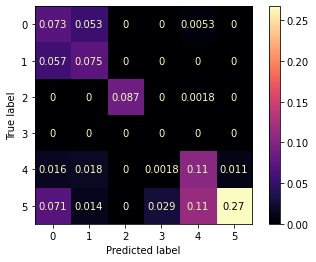

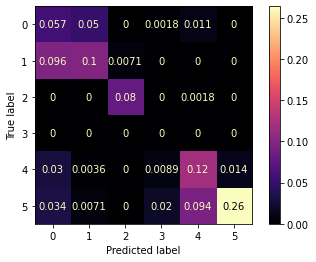

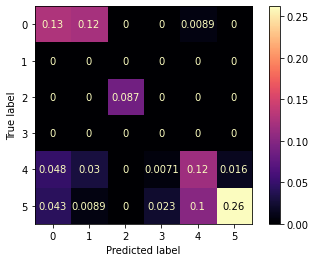

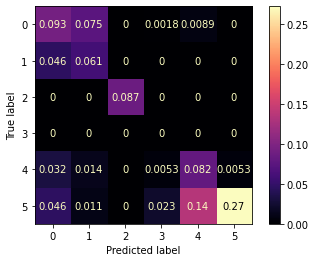

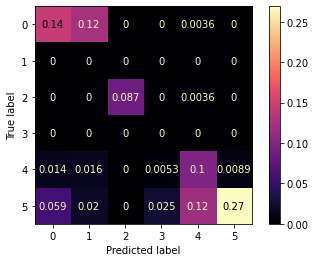

In [ ]:
for z,i in enumerate(allypred):
    print("Confusion Matrix for the first iterate",z+1)
    ConfusionMatrixDisplay(confusion_matrix(i,y_test,normalize="all"),display_labels = s).plot(cmap=plt.cm.magma)

##**Average Confusion Matrix **

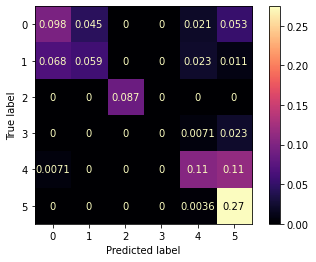

In [ ]:
ConfusionMatrixDisplay(confusion_matrix(y_test,vote(allypred),normalize="all"),display_labels = s).plot(cmap=plt.cm.magma)

##**TSNE Plots**

###Train data

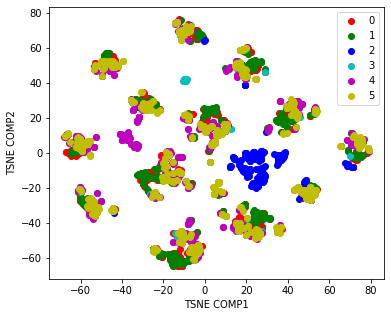

In [ ]:
plot(X_train,y_train)

###Test data

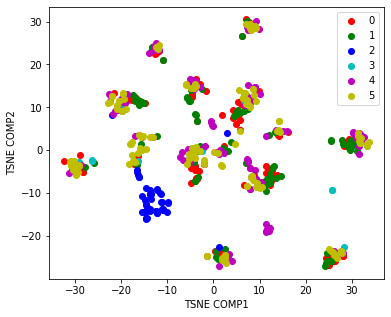

In [ ]:
plot(X_test,y_test)

###Validation data

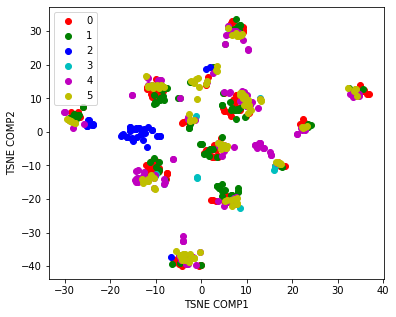

In [ ]:
plot(X_val,y_val)

# **Compre dimensionality reduction to feature selection **

#**PCA**

In [ ]:
component=2
model = Sequential()
scorepca,accpca=callmodel(X_train, y_train, X_test, y_test,X_val,y_val,  PCA(n_components=component,random_state=0), model)

Epoch 1/100
2600/2619 [============================>.] - ETA: 0s - loss: 1.7340 - accuracy: 0.3304
Epoch 1: val_accuracy improved from -inf to 0.33155, saving model to ./maboe017/weights-improvement-best.hdf5
2619/2619 [==============================] - 3s 1ms/step - loss: 1.7336 - accuracy: 0.3299 - val_loss: 1.6858 - val_accuracy: 0.3316
Epoch 2/100
2563/2619 [============================>.] - ETA: 0s - loss: 1.6666 - accuracy: 0.3632
Epoch 2: val_accuracy did not improve from 0.33155
2619/2619 [==============================] - 3s 955us/step - loss: 1.6670 - accuracy: 0.3627 - val_loss: 1.6837 - val_accuracy: 0.3191
Epoch 3/100
2605/2619 [============================>.] - ETA: 0s - loss: 1.6531 - accuracy: 0.3689

Maximum accuracy: 0.51871657371521
Best number of features: 12


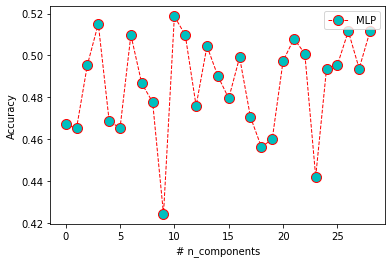

In [ ]:
components=range(29)
plt.plot(components,scorepca ,color='red', linestyle='dashed', linewidth = 1, marker='o', markerfacecolor='c', markersize=10)
plt.xlabel('# n_components')
plt.ylabel('Accuracy')
plt.legend( ['MLP'])
gethigh(accpca)

##**PCA best n_compenets**

In [ ]:
pca = PCA(n_components=12,random_state=0)
pca_trdata=pca.fit_transform(X_train)
pca_tedata=pca.transform(X_test)
pca_vadata=pca.transform(X_val)

##**TSNE after PCA**

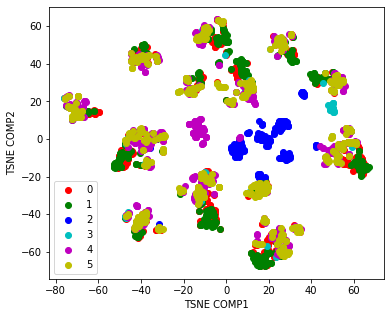

In [ ]:
plot(pca_trdata,y_train)

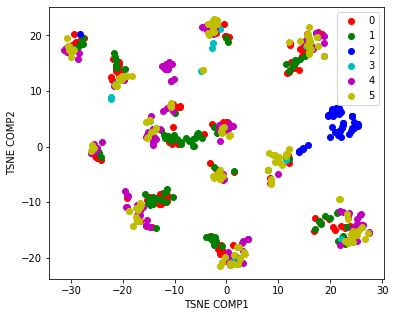

In [ ]:
plot(pca_tedata,y_test)

#**Feature Selection Mutual info**

In [ ]:
nf=2
scorefs,accdict=callmodel(X_train, y_train, X_test, y_test,X_val,y_val,  SelectKBest(mutual_info_classif, k=nf), model)

Epoch 1/100
2591/2619 [============================>.] - ETA: 0s - loss: 1.7218 - accuracy: 0.3466
Epoch 1: val_accuracy improved from -inf to 0.32977, saving model to ./maboe017/weights-improvement-best.hdf5
2619/2619 [==============================] - 3s 1ms/step - loss: 1.7205 - accuracy: 0.3494 - val_loss: 1.6595 - val_accuracy: 0.3298
Epoch 2/100
2594/2619 [============================>.] - ETA: 0s - loss: 1.6633 - accuracy: 0.3967
Epoch 2: val_accuracy improved from 0.32977 to 0.38324, saving model to ./maboe017/weights-improvement-best.hdf5
2619/2619 [==============================] - 3s 1ms/step - loss: 1.6632 - accuracy: 0.3956 - val_loss: 1.6560 - val_accuracy: 0.3832
Epoch 3/100
2618/2619 [============================>.] - ETA: 0s - loss: 1.6682 - accuracy: 0.3846

##**Mutual Class info PLOT**

Maximum accuracy: 0.5240641832351685
Best number of features: 22


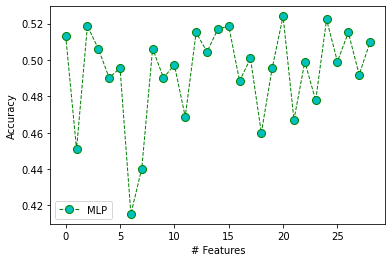

In [ ]:
bestnfeature=range(29)
plt.plot(bestnfeature,scorefs,color='green', linestyle='dashed', linewidth = 1, marker='o', markerfacecolor='c', markersize=8)
plt.xlabel('# Features')
plt.ylabel('Accuracy')
plt.legend( ['MLP'])
gethigh(accdict)

#**Feature Selection ANOVA**

In [ ]:
nf=2
model = Sequential()
scorefs2,accdict2=callmodel(X_train, y_train, X_test, y_test,X_val,y_val, SelectKBest(f_classif, k=nf), model)

Epoch 1/100
2596/2619 [============================>.] - ETA: 0s - loss: 1.7199 - accuracy: 0.3320
Epoch 1: val_accuracy improved from -inf to 0.30303, saving model to ./maboe017/weights-improvement-best.hdf5
2619/2619 [==============================] - 3s 1ms/step - loss: 1.7194 - accuracy: 0.3333 - val_loss: 1.6897 - val_accuracy: 0.3030
Epoch 2/100
2619/2619 [==============================] - ETA: 0s - loss: 1.6705 - accuracy: 0.3620
Epoch 2: val_accuracy did not improve from 0.30303
2619/2619 [==============================] - 2s 950us/step - loss: 1.6705 - accuracy: 0.3620 - val_loss: 1.6879 - val_accuracy: 0.2763
Epoch 3/100
2575/2619 [============================>.] - ETA: 0s - loss: 1.6715 - accuracy: 0.3503

##**ANOVA PLOT**

In [ ]:
bestnfeature=range(29)
plt.plot(bestnfeature,scorefs2,color='green', linestyle='dashed', linewidth = 1, marker='o', markerfacecolor='c', markersize=8)
plt.xlabel('# Features')
plt.ylabel('Accuracy')
plt.legend( ['MLP'])
gethigh(accdict2)

##**Updating Dataset to the new one using ANOVA**

In [16]:
fs=SelectKBest(f_classif, k=7)
fs.fit(X_train, y_train)
X_train_new = fs.transform(X_train)
X_test_new = fs.transform(X_test)
X_val_new = fs.transform(X_val)

##**TSNE Using New DataSet**

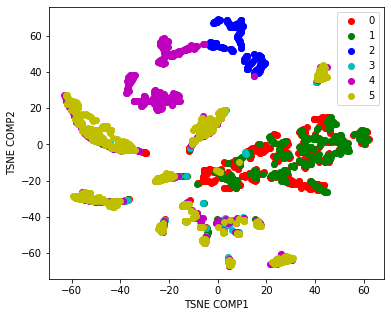

In [ ]:
plot(X_train_new,y_train)

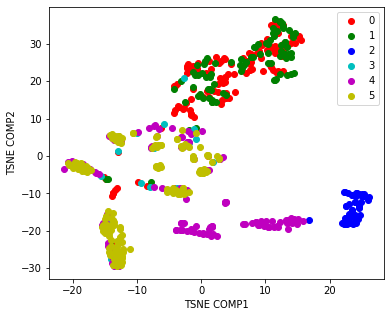

In [ ]:
plot(X_test_new,y_test)

##**Confusion Matrix with New DataSet**

Epoch 1/500
2579/2619 [============================>.] - ETA: 0s - loss: 1.6654 - accuracy: 0.4645
Epoch 1: val_accuracy improved from -inf to 0.42424, saving model to ./Users/maboe017/improve-best.hdf5
2619/2619 [==============================] - 3s 1ms/step - loss: 1.6631 - accuracy: 0.4670 - val_loss: 1.5684 - val_accuracy: 0.4242
Epoch 2/500
2597/2619 [============================>.] - ETA: 0s - loss: 1.5957 - accuracy: 0.4913
Epoch 2: val_accuracy did not improve from 0.42424
2619/2619 [==============================] - 3s 1ms/step - loss: 1.5952 - accuracy: 0.4914 - val_loss: 1.5919 - val_accuracy: 0.4189
Epoch 3/500
2609/2619 [============================>.] - ETA: 0s - loss: 1.5851 - accuracy: 0.4458
Epoch 3: v

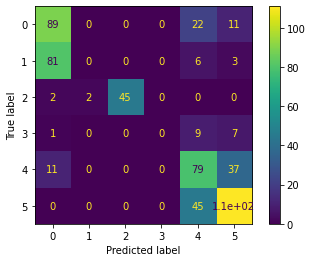

In [ ]:
filepath="./Users/maboe017/improve-best.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]
model = Sequential()
optimizer = tfa.optimizers.AdamW(learning_rate=0.001,weight_decay=0.004)
model.add(Dense(10, input_shape = (X_train_new.shape[1],), activation = "relu"))
model.add(Dense(6, activation = "softmax"))
model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
model.fit(X_train_new,y_train, validation_data=(X_val_new,y_val), epochs=500, batch_size=1,callbacks= callbacks_list)
model.load_weights(filepath)
print("Accuracy",model.evaluate(X_test_new,y_test ,verbose=0)[1])
newpred=model.predict(X_test_new)
y_pred_new = np.argmax(newpred, axis=1)
ConfusionMatrixDisplay(confusion_matrix(y_test,y_pred_new),display_labels = s).plot()

#**Impact of batch size on MLP**

In [ ]:
batch=[32,64,128]
results=[]
scorebatch=[]
for x in range(5):
    for i in batch:
        filepath="./maboe017/weights-improvement-best.hdf5"
        checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
        callbacks_list = [checkpoint]
        optimizer = tfa.optimizers.AdamW(learning_rate=0.001,weight_decay=0.004)
        model = keras.Sequential()
        model.add(Dense(10, input_shape = (X_train_new.shape[1],), activation = "relu"))
        model.add(Dense(6, activation = "softmax"))
        model.summary()
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        history=model.fit(X_train_new,y_train, validation_data=(X_test_new,y_test), epochs=500, batch_size=i,callbacks= callbacks_list)
        print(model.history.history.keys())
        results.append({" iteration ":x,"batch":i," max train": max(model.history.history['accuracy']),"min train":min(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])," Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})
        model.load_weights(filepath)
        print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
        scorebatch.append(100*model.evaluate(X_test_new,y_test, verbose=0)[1])

Model: "sequential_98"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_190 (Dense)           (None, 10)                80        
                                                                 
 dense_191 (Dense)           (None, 6)                 66        
                                                                 
Total params: 146
Trainable params: 146
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
50/82 [=================>............] - ETA: 0s - loss: 1.7035 - accuracy: 0.2788 
Epoch 1: val_accuracy improved from -inf to 0.38324, saving model to ./maboe017/weights-improvement-best.hdf5
82/82 [==============================] - 1s 5ms/step - loss: 1.6453 - accuracy: 0.3226 - val_loss: 1.5391 - val_accuracy: 0.3832
Epoch 2/500
56/82 [==============

##**Results of Changing BatchSize**

In [ ]:
batchdf=sortResult(results," iteration ")
#batchdf.loc[batchdf['batch'] == 128]
batchdf


,iteration,batch,max train,min train,max test,min test,avg train acc,avg test acc,Score
0,0,32,0.597556,0.322642,0.609626,0.383244,0.576937,0.588285,0.584670
1,0,64,0.622375,0.136693,0.629234,0.196078,0.574839,0.592360,0.602496
2,0,128,0.612066,0.232913,0.634581,0.304813,0.585224,0.605533,0.632799
3,1,32,0.626575,0.389843,0.636364,0.426025,0.554285,0.562642,0.545455
4,1,64,0.603666,0.300496,0.629234,0.377897,0.573941,0.595786,0.618538
5,1,128,0.609775,0.088583,0.634581,0.137255,0.585902,0.604520,0.629234
6,2,32,0.621993,0.276060,0.620321,0.445633,0.577756,0.588217,0.595365
7,2,64,0.595265,0.316151,0.622103,0.401070,0.566747,0.586774,0.609626
8,2,128,0.633448,0.200076,0.647059,0.217469,0.585182,0.603847,0.588235
9,3,32,0.588011,0.366934,0.620321,0.377897,0.547666,0.556307,0.554367


#**Using different hidden layers and nuerons, with best batch-size**

In [ ]:
nueron=[10,20,30,40]
hlayer=[1,2,4,8]
scorelayer=[]
resultslayer=[]
for x in hlayer:
    for i in nueron:
        filepath="./maboe017/weights-improvement-best.hdf5"
        checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
        callbacks_list = [checkpoint]
        optimizer = tfa.optimizers.AdamW(learning_rate=0.001,weight_decay=0.004)
        if i in nueron and x==1:
            model = keras.Sequential()
            model.add(Dense(i, input_shape = (X_train_new.shape[1],), activation = "tanh"))
            model.add(Dense(6, activation = "softmax"))
            model.summary()
            model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
            history=model.fit(X_train_new,y_train, validation_data=(X_val_new,y_val), epochs=500, batch_size=128,callbacks= callbacks_list)
            resultslayer.append({" layer ":x,"neruon":i,"max train":max(model.history.history["accuracy"]),"min train":min(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])," Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})
            model.load_weights(filepath)
            print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
            smodel=100*model.evaluate(X_test_new,y_test, verbose=0)[1]
            scorelayer.append({"best model":smodel,"layer":x,"nueron":i})
        elif i in nueron and x==2:
            model = keras.Sequential()
            model.add(Dense(i, input_shape = (X_train_new.shape[1],), activation = "tanh"))
            model.add(Dense(i,  activation = "relu"))
            model.add(Dense(6, activation = "softmax"))
            model.summary()
            model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
            history=model.fit(X_train_new,y_train, validation_data=(X_val_new,y_val), epochs=500, batch_size=128,callbacks= callbacks_list)
            resultslayer.append({" layer ":x,"neruon":i,"max train":max(model.history.history["accuracy"]),"min train":min(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])," Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})
            model.load_weights(filepath)
            print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
            smodel=100*model.evaluate(X_test_new,y_test, verbose=0)[1]
            scorelayer.append({"best model":smodel,"layer":x,"nueron":i})
        elif i in nueron and x==4:
            model = keras.Sequential()
            model.add(Dense(i, input_shape = (X_train_new.shape[1],), activation = "tanh"))
            model.add(Dense(i,  activation = "relu"))
            model.add(Dense(i,  activation = "relu"))
            model.add(Dense(6, activation = "softmax"))
            model.summary()
            model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
            history=model.fit(X_train_new,y_train, validation_data=(X_val_new,y_val), epochs=500, batch_size=128,callbacks= callbacks_list)
            resultslayer.append({" layer ":x,"neruon":i,"max train":max(model.history.history["accuracy"]),"min train":min(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])," Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})
            model.load_weights(filepath)
            print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
            smodel=100*model.evaluate(X_test_new,y_test, verbose=0)[1]
            scorelayer.append({"best model":smodel,"layer":x,"nueron":i})
        elif i in nueron and x==8:
            model = keras.Sequential()
            model.add(Dense(i, input_shape = (X_train_new.shape[1],), activation = "relu"))
            model.add(Dense(i, activation = "relu"))
            model.add(Dense(i, activation = "relu"))
            model.add(Dense(i, activation = "relu"))
            model.add(Dense(i, activation = "relu"))
            model.add(Dense(i, activation = "relu"))
            model.add(Dense(i, activation = "relu"))
            model.add(Dense(i, activation = "relu"))
            model.add(Dense(i, activation = "relu"))
            model.add(Dense(6, activation = "softmax"))
            model.summary()
            model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
            history=model.fit(X_train_new,y_train, validation_data=(X_val_new,y_val), epochs=500, batch_size=128,callbacks= callbacks_list)
            resultslayer.append({" layer ":x,"neruon":i,"max train":max(model.history.history["accuracy"]),"min train":min(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])," Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})
            model.load_weights(filepath)
            print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
            smodel=100*model.evaluate(X_test_new,y_test, verbose=0)[1]
            scorelayer.append({"best model":smodel,"layer":x,"nueron":i})

Model: "sequential_480"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3283 (Dense)          (None, 10)                80        
                                                                 
 dense_3284 (Dense)          (None, 6)                 66        
                                                                 
Total params: 146
Trainable params: 146
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
 1/21 [>.............................] - ETA: 5s - loss: 1.8723 - accuracy: 0.0859
Epoch 1: val_accuracy improved from -inf to 0.11943, saving model to ./maboe017/weights-improvement-best.hdf5
21/21 [==============================] - 1s 13ms/step - loss: 1.8249 - accuracy: 0.0859 - val_loss: 1.7651 - val_accuracy: 0.1194
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7758 - accuracy: 0.1250
Epoch 2: val_accurac

##**Results Using different Layers and Nuerons**

In [ ]:
dfneuron=sortResult(resultslayer," layer ")
dfneuron

,layer,neruon,max train,min train,max test,min test,avg train acc,avg test acc,Score
0,1,10,0.627339,0.085911,0.629234,0.119430,0.605145,0.607337,0.639929
1,1,20,0.639557,0.431081,0.638146,0.465241,0.626201,0.626132,0.639929
2,1,30,0.650630,0.258877,0.643494,0.308378,0.639843,0.635676,0.650624
3,1,40,0.654448,0.249332,0.650624,0.475936,0.643638,0.641554,0.664884
4,2,10,0.626575,0.109202,0.634581,0.144385,0.606484,0.614513,0.641711
5,2,20,0.661703,0.261168,0.661319,0.356506,0.652118,0.651936,0.684492
6,2,30,0.668958,0.302787,0.672014,0.477718,0.660980,0.664107,0.682709
7,2,40,0.676976,0.376098,0.675579,0.468806,0.668101,0.669815,0.688057
8,4,10,0.621611,0.160748,0.631016,0.240642,0.544215,0.546588,0.577540
9,4,20,0.667049,0.296678,0.672014,0.454545,0.646196,0.656428,0.672014


##Plotting 4 lines 

Text(0, 0.5, 'Accuracy')

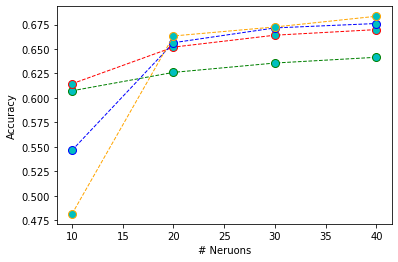

In [ ]:
nueron=[10,20,30,40]
lay1=dfneuron[dfneuron[" layer "]==1]
lay2=dfneuron[dfneuron[" layer "]==2]
lay4=dfneuron[dfneuron[" layer "]==4]
lay8=dfneuron[dfneuron[" layer "]==8]


plt.plot(nueron,lay1["avg test acc"],color='green', linestyle='dashed', linewidth = 1, marker='o', markerfacecolor='c', markersize=8)
plt.plot(nueron,lay2["avg test acc"],color='red', linestyle='dashed', linewidth = 1, marker='o', markerfacecolor='c', markersize=8)
plt.plot(nueron,lay4["avg test acc"],color='blue', linestyle='dashed', linewidth = 1, marker='o', markerfacecolor='c', markersize=8)
plt.plot(nueron,lay8["avg test acc"],color='orange', linestyle='dashed', linewidth = 1, marker='o', markerfacecolor='c', markersize=8)
plt.xlabel('# Neruons')
plt.ylabel('Accuracy')
plt.legend( ["Hidden layer=1","Hidden layer=2","Hidden layer=4","Hidden layer=8"])

#**Learning rate and different optimizers with best Previous Parameters**

In [ ]:
learningrate=[0.1,0.01,.001]
momen=[0.1,0.5,0.9]
resultslr=[]
scorelearn=[]
optimizers=[tfa.optimizers.AdamW,tf.optimizers.SGD,tf.optimizers.RMSprop]
names=["adam","sgd","prob"]
for n in range(5):
    for x,z in zip(optimizers,names):
        for i in learningrate:
            filepath="./maboe017/weights-improvement-best.hdf5"
            checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
            callbacks_list = [checkpoint]
            if x ==tfa.optimizers.AdamW and i in learningrate:
                optimizer = x(learning_rate=i,weight_decay=0.004)
                model = keras.Sequential()
                model.add(Dense(40, input_shape = (X_train_new.shape[1],), activation = "tanh"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(6, activation = "softmax"))
                model.summary()
                model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
                history=model.fit(X_train_new,y_train, validation_data=(X_val_new,y_val), epochs=50, batch_size=128,callbacks= callbacks_list)
                resultslr.append({" optimizer ":z,"LearningRate":i,"min train":min(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy'])," max train": max(model.history.history['accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])})
                model.load_weights(filepath)
                print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
                scorelearn.append({" optimizer ":z,"LearningRate":i," Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})
            elif x ==tf.optimizers.SGD and i in learningrate:
                for m in momen:
                    optimizer = x(learning_rate=i,momentum=m)
                    model = keras.Sequential()
                    model.add(Dense(40, input_shape = (X_train_new.shape[1],), activation = "tanh"))
                    model.add(Dense(40, activation = "relu"))
                    model.add(Dense(40, activation = "relu"))
                    model.add(Dense(40, activation = "relu"))
                    model.add(Dense(40, activation = "relu"))
                    model.add(Dense(40, activation = "relu"))
                    model.add(Dense(40, activation = "relu"))
                    model.add(Dense(40, activation = "relu"))
                    model.add(Dense(40, activation = "relu"))
                    model.add(Dense(6, activation = "softmax"))
                    model.summary()
                    model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
                    history=model.fit(X_train_new,y_train, validation_data=(X_val_new,y_val), epochs=50, batch_size=128,callbacks= callbacks_list)
                    resultslr.append({" optimizer ":z,"LearningRate":i,"momentum":m,"min train":min(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy'])," max train": max(model.history.history['accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])})
                    model.load_weights(filepath)
                    print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
                    scorelearn.append({" optimizer ":z,"LearningRate":i," Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})
            elif x ==tf.optimizers.RMSprop and i in learningrate:
                optimizer = x(learning_rate=i,momentum=m)
                model = keras.Sequential()
                model.add(Dense(40, input_shape = (X_train_new.shape[1],), activation = "tanh"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(40, activation = "relu"))
                model.add(Dense(6, activation = "softmax"))
                model.summary()
                model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
                history=model.fit(X_train_new,y_train, validation_data=(X_val_new,y_val), epochs=50, batch_size=128,callbacks= callbacks_list)
                resultslr.append({" optimizer ":z,"LearningRate":i,"min train":min(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy'])," max train": max(model.history.history['accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])})
                model.load_weights(filepath)
                print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
                scorelearn.append({" optimizer ":z,"LearningRate":i," Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})

**Results Learning rate and different optimizers**

In [ ]:
dflr=sortResult(resultslr, "min train" )
dflr
# ff=dflr.loc[dflr[' optimizer '] == "prob"]
# dd=ff.loc[ff['momentum'] == 0.9]
# ff.loc[ff['LearningRate'] == 0.001]

,optimizer,LearningRate,min train,max test,max train,min test,avg train acc,avg test acc,momentum
24,sgd,0.001,0.008782,0.219251,0.248568,0.003565,0.231699,0.207130,0.1
41,sgd,0.001,0.155403,0.577540,0.551737,0.156863,0.426598,0.445134,0.9
62,adam,0.001,0.160367,0.702317,0.694158,0.203209,0.661352,0.668271,NaN
39,sgd,0.001,0.163421,0.301248,0.305842,0.226381,0.266903,0.262995,0.1
66,sgd,0.010,0.165712,0.654189,0.626957,0.219251,0.424849,0.418538,0.1
...,...,...,...,...,...,...,...,...,...
14,prob,0.001,0.455899,0.771836,0.747232,0.625668,0.712127,0.732620,NaN
74,prob,0.001,0.461627,0.762923,0.746086,0.611408,0.711569,0.726702,NaN
31,adam,0.010,0.476518,0.734403,0.691485,0.538324,0.650187,0.665383,NaN
1,adam,0.010,0.483009,0.727273,0.694540,0.324421,0.612005,0.623565,NaN


#**Using different Activation Functions**

In [17]:
activefun=['tanh','sigmoid','relu',tf.keras.layers.LeakyReLU()]
resultsactive=[]
scoreactive=[]
for i in activefun:
    if i in activefun:
        filepath="./maboe017/weights-improvement-best.hdf5"
        checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
        callbacks_list = [checkpoint]
        optimizer = tf.optimizers.RMSprop(learning_rate=0.001,momentum=0.5)
        model = keras.Sequential()
        model.add(Dense(40, input_shape = (X_train_new.shape[1],),activation = "tanh"))
        model.add(Dense(40, activation = i))
        model.add(Dense(40, activation = i))
        model.add(Dense(40, activation = i))
        model.add(Dense(40, activation = i))
        model.add(Dense(40, activation = i))
        model.add(Dense(40, activation = i))
        model.add(Dense(40, activation = i))
        model.add(Dense(40, activation = i))
        model.add(Dense(6, activation = "softmax"))
        model.summary()
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        history=model.fit(X_train_new,y_train, validation_data=(X_test_new,y_test), epochs=500, batch_size=128,callbacks= callbacks_list)
        resultsactive.append({" active type ":i,"min train":min(model.history.history["accuracy"]),"max train":max(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])})
        model.load_weights(filepath)
        print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
        scoreactive.append({" active type ":i," Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})
    else:
        filepath="./maboe017/weights-improvement-best.hdf5"
        checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
        callbacks_list = [checkpoint]
        optimizer = tf.optimizers.RMSprop(learning_rate=0.001,momentum=0.5)
        model = keras.Sequential()
        model.add(Dense(40, input_shape = (X_train_new.shape[1],),activation = "tanh"))
        model.add(Dense(40,activation = tf.keras.layers.LeakyReLU(alpha=0.5)))
        model.add(Dense(40, activation = tf.keras.layers.LeakyReLU(alpha=0.5)))
        model.add(Dense(40, activation = tf.keras.layers.LeakyReLU(alpha=0.5)))
        model.add(Dense(40, activation = tf.keras.layers.LeakyReLU(alpha=0.5)))
        model.add(Dense(40, activation = tf.keras.layers.LeakyReLU(alpha=0.5)))
        model.add(Dense(40, activation = tf.keras.layers.LeakyReLU(alpha=0.5)))
        model.add(Dense(40, activation = tf.keras.layers.LeakyReLU(alpha=0.5)))
        model.add(Dense(6, activation = "softmax"))
        model.summary()
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        history=model.fit(X_train_new,y_train, validation_data=(X_test_new,y_test), epochs=500, batch_size=128,callbacks= callbacks_list)
        resultsactive.append({" active type ":i,"min train":min(model.history.history["accuracy"]),"max train":max(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])})
        model.load_weights(filepath)
        print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
        scoreactive.append({" active type ":i," Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 40)                320       
                                                                 
 dense_1 (Dense)             (None, 40)                1640      
                                                                 
 dense_2 (Dense)             (None, 40)                1640      
                                                                 
 dense_3 (Dense)             (None, 40)                1640      
                                                                 
 dense_4 (Dense)             (None, 40)                1640      
                                                                 
 dense_5 (Dense)             (None, 40)                1640      
                                                                 
 dense_6 (Dense)             (None, 40)               

**Results Using different Activation Functions**

In [18]:
sortResult(resultsactive,"min train")

,active type,min train,max train,max test,min test,avg train acc,avg test acc
1,sigmoid,0.226040,0.261550,0.278075,0.217469,0.248700,0.242456
2,relu,0.486827,0.844979,0.816399,0.552585,0.799279,0.775626
3,<keras.layers.activation.leaky_relu.LeakyReLU ...,0.511646,0.817106,0.825312,0.475936,0.776891,0.770631
0,tanh,0.572738,0.825888,0.800357,0.593583,0.777259,0.761034


#**Bounce Question**

In [19]:
resultsbounce=[]
scorebounce=[]
filepath="./maboe017/weights-improvement-best.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]
optimizer = tf.optimizers.RMSprop(learning_rate=0.001,momentum=0.5)
model = keras.Sequential()
model.add(Dense(40, input_shape = (X_train_new.shape[1],), activation ="relu"))
model.add(Dense(40,activation = "relu"))
model.add(Dense(40, activation = "relu"))
model.add(Dense(40, activation = "relu"))
model.add(Dense(40, activation = "relu"))
model.add(Dense(40, activation = "relu"))
model.add(Dense(40, activation = "relu"))
model.add(Dense(40, activation = "relu"))
model.add(Dense(6, activation = "softmax"))
model.summary()
model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
history=model.fit(X_train_new,y_train, validation_data=(X_test_new,y_test), epochs=500, batch_size=128,callbacks= callbacks_list)
resultsbounce.append({"min train":min(model.history.history["accuracy"]),"max train":max(model.history.history["accuracy"])," max test": max(model.history.history['val_accuracy']),"min test":min(model.history.history["val_accuracy"]),"avg train acc":sum(model.history.history["accuracy"])/len(model.history.history["accuracy"]),"avg test acc":sum(model.history.history["val_accuracy"])/len(model.history.history["val_accuracy"])})
model.load_weights(filepath)
print('Test accuracy: %.2f %%'%(100*model.evaluate(X_test_new,y_test, verbose=0)[1]))
scorebounce.append({" Score ": model.evaluate(X_test_new,y_test, verbose=0)[1]})

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_40 (Dense)            (None, 40)                320       
                                                                 
 dense_41 (Dense)            (None, 40)                1640      
                                                                 
 dense_42 (Dense)            (None, 40)                1640      
                                                                 
 dense_43 (Dense)            (None, 40)                1640      
                                                                 
 dense_44 (Dense)            (None, 40)                1640      
                                                                 
 dense_45 (Dense)            (None, 40)                1640      
                                                                 
 dense_46 (Dense)            (None, 40)               

Bounce Question Results

In [20]:
sortResult(resultsbounce,"min train")

,min train,max train,max test,min test,avg train acc,avg test acc
0,0.435662,0.849561,0.821747,0.509804,0.804692,0.779854
